<a href="https://www.kaggle.com/code/mohammedmohsen0404/sonar-rock-vs-mine-prediction?scriptVersionId=188650275" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

---
**<center><h1>SONAR Rock Vs Mine Prediction</h1></center>**
<center><h3>Part of 100 Days 100 ML Projects Challenge</h3></center>

---




The SONAR Rock Vs Mine Prediction falls under **Classication Machine Learning Problem**. The project aims to develop a machine learning model capable of accurately distinguishing between metal cylinders(mines) and rocks based on SONAR return data.

# **Import Libraries and Data**
---

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [2]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
import xgboost as xgb
from sklearn.metrics import classification_report , f1_score

In [3]:
data = pd.read_csv('/kaggle/input/rock-vs-mine-prediction-machine-learning/Sonar dataset.csv', header = None)
df=data.copy()

# **Take a look at the data**
---

In [4]:
df.head()

,0,1,2,3,4,5,6,7,8,9,...,51,52,53,54,55,56,57,58,59,60
0,0.0200,0.0371,0.0428,0.0207,0.0954,0.0986,0.1539,0.1601,0.3109,0.2111,...,0.0027,0.0065,0.0159,0.0072,0.0167,0.0180,0.0084,0.0090,0.0032,R
1,0.0453,0.0523,0.0843,0.0689,0.1183,0.2583,0.2156,0.3481,0.3337,0.2872,...,0.0084,0.0089,0.0048,0.0094,0.0191,0.0140,0.0049,0.0052,0.0044,R
2,0.0262,0.0582,0.1099,0.1083,0.0974,0.2280,0.2431,0.3771,0.5598,0.6194,...,0.0232,0.0166,0.0095,0.0180,0.0244,0.0316,0.0164,0.0095,0.0078,R
3,0.0100,0.0171,0.0623,0.0205,0.0205,0.0368,0.1098,0.1276,0.0598,0.1264,...,0.0121,0.0036,0.0150,0.0085,0.0073,0.0050,0.0044,0.0040,0.0117,R
4,0.0762,0.0666,0.0481,0.0394,0.0590,0.0649,0.1209,0.2467,0.3564,0.4459,...,0.0031,0.0054,0.0105,0.0110,0.0015,0.0072,0.0048,0.0107,0.0094,R


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 208 entries, 0 to 207
Data columns (total 61 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       208 non-null    float64
 1   1       208 non-null    float64
 2   2       208 non-null    float64
 3   3       208 non-null    float64
 4   4       208 non-null    float64
 5   5       208 non-null    float64
 6   6       208 non-null    float64
 7   7       208 non-null    float64
 8   8       208 non-null    float64
 9   9       208 non-null    float64
 10  10      208 non-null    float64
 11  11      208 non-null    float64
 12  12      208 non-null    float64
 13  13      208 non-null    float64
 14  14      208 non-null    float64
 15  15      208 non-null    float64
 16  16      208 non-null    float64
 17  17      208 non-null    float64
 18  18      208 non-null    float64
 19  19      208 non-null    float64
 20  20      208 non-null    float64
 21  21      208 non-null    float64
 22  22

In [6]:
df.shape

(208, 61)

In [7]:
df.describe()

,0,1,2,3,4,5,6,7,8,9,...,50,51,52,53,54,55,56,57,58,59
count,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,...,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000
mean,0.029164,0.038437,0.043832,0.053892,0.075202,0.104570,0.121747,0.134799,0.178003,0.208259,...,0.016069,0.013420,0.010709,0.010941,0.009290,0.008222,0.007820,0.007949,0.007941,0.006507
std,0.022991,0.032960,0.038428,0.046528,0.055552,0.059105,0.061788,0.085152,0.118387,0.134416,...,0.012008,0.009634,0.007060,0.007301,0.007088,0.005736,0.005785,0.006470,0.006181,0.005031
min,0.001500,0.000600,0.001500,0.005800,0.006700,0.010200,0.003300,0.005500,0.007500,0.011300,...,0.000000,0.000800,0.000500,0.001000,0.000600,0.000400,0.000300,0.000300,0.000100,0.000600
25%,0.013350,0.016450,0.018950,0.024375,0.038050,0.067025,0.080900,0.080425,0.097025,0.111275,...,0.008425,0.007275,0.005075,0.005375,0.004150,0.004400,0.003700,0.003600,0.003675,0.003100
50%,0.022800,0.030800,0.034300,0.044050,0.062500,0.092150,0.106950,0.112100,0.152250,0.182400,...,0.013900,0.011400,0.009550,0.009300,0.007500,0.006850,0.005950,0.005800,0.006400,0.005300
75%,0.035550,0.047950,0.057950,0.064500,0.100275,0.134125,0.154000,0.169600,0.233425,0.268700,...,0.020825,0.016725,0.014900,0.014500,0.012100,0.010575,0.010425,0.010350,0.010325,0.008525
max,0.137100,0.233900,0.305900,0.426400,0.401000,0.382300,0.372900,0.459000,0.682800,0.710600,...,0.100400,0.070900,0.039000,0.035200,0.044700,0.039400,0.035500,0.044000,0.036400,0.043900


In [8]:
df.iloc[:,60].value_counts()

60
M    111
R     97
Name: count, dtype: int64

# **Exploratory Data Analysis**
---

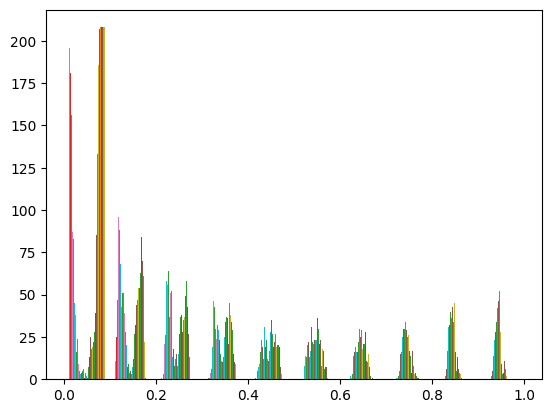

In [9]:
plt.hist (df.drop(df.columns[60], axis = 1))
plt.show()

**Univariate Analysis**

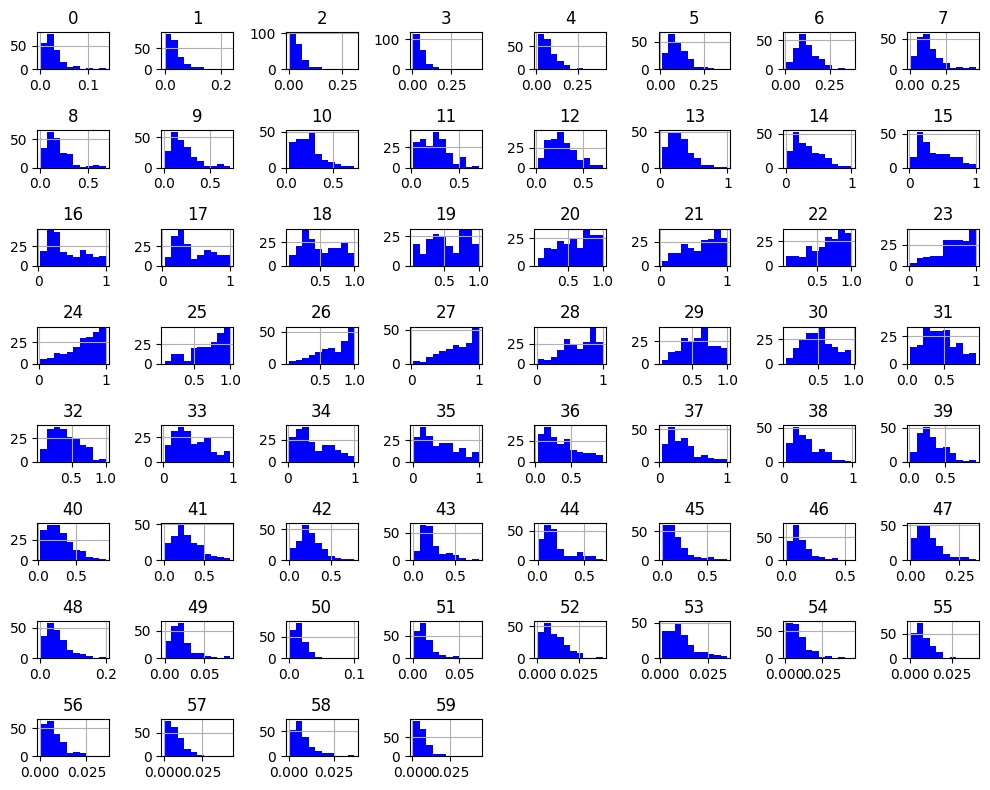

In [10]:
numerical_data = data.select_dtypes(include='number')
numerical_data.hist(figsize=(10, 8),color = 'b')
plt.tight_layout()
plt.show()

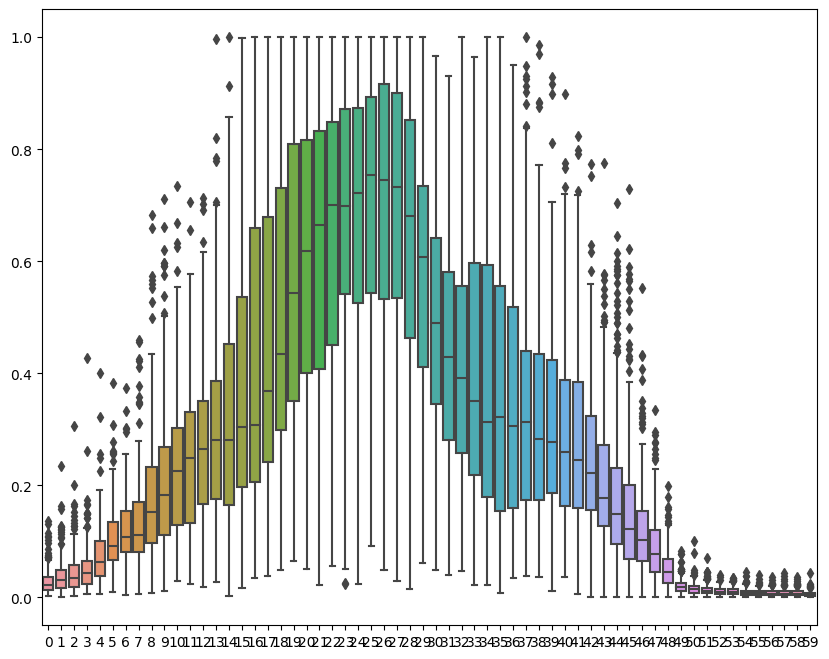

In [11]:
plt.figure(figsize=(10, 8))
sns.boxplot(numerical_data)
plt.show()

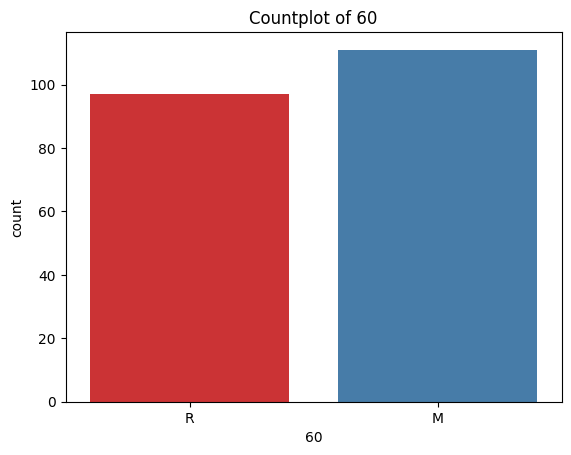

In [12]:
categorical_data = data.select_dtypes(include='object')
for column in categorical_data.columns:
    sns.countplot(data=categorical_data, x=column, palette="Set1")
    plt.title(f"Countplot of {column}")
    plt.show()

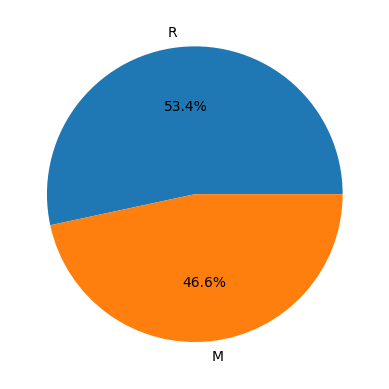

In [13]:
plt.pie(df.iloc[:,60].value_counts(), labels=['R','M'], autopct='%1.1f%%')
plt.show()

**Multivariate Analysis**

In [14]:
sns.pairplot(data.select_dtypes(include='number'))
plt.show()

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  

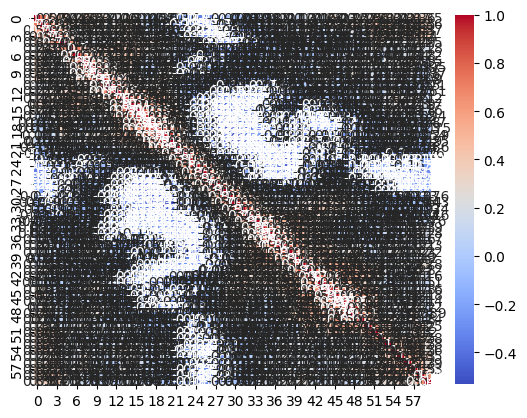

In [15]:
sns.heatmap(numerical_data.corr(), annot=True, cmap='coolwarm')
plt.show()

# **Data Cleaning**
---

**Handling Duplicate Rows**

In [16]:
# Check for duplicate rows
duplicate_rows = df.duplicated()
# Count of duplicate rows
print(f"Number of duplicate rows: {duplicate_rows.sum()}")

Number of duplicate rows: 0


**Handling Missing Data**

In [17]:
total = data.isnull().sum().sort_values(ascending=False)
percent = (data.isnull().sum()/data.isnull().count()).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data.head(10)

,Total,Percent
0,0,0.0
31,0,0.0
33,0,0.0
34,0,0.0
35,0,0.0
36,0,0.0
37,0,0.0
38,0,0.0
39,0,0.0
40,0,0.0


In [18]:
total = data.isnull().sum().sum()
print('Total Null values =' ,total)

Total Null values = 0


# **Data Preprocesing**
----

It's important to conduct preprocessing steps separately on train, test sets to avoid data leakage, which can lead to overly optimistic performance estimates.
so let's split the data

**Data Splitting**

In [19]:
X = df.drop(df.columns[60], axis = 1)
y = df.iloc[:,60]

In [20]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=.3,random_state=101)

**Encoding Categorical Variables**

In [21]:
y_train = y_train.apply(lambda x : 0 if x == 'R' else 1)
y_test = y_test.apply(lambda x : 0 if x == 'R' else 1)

**Dealing with Outliers**

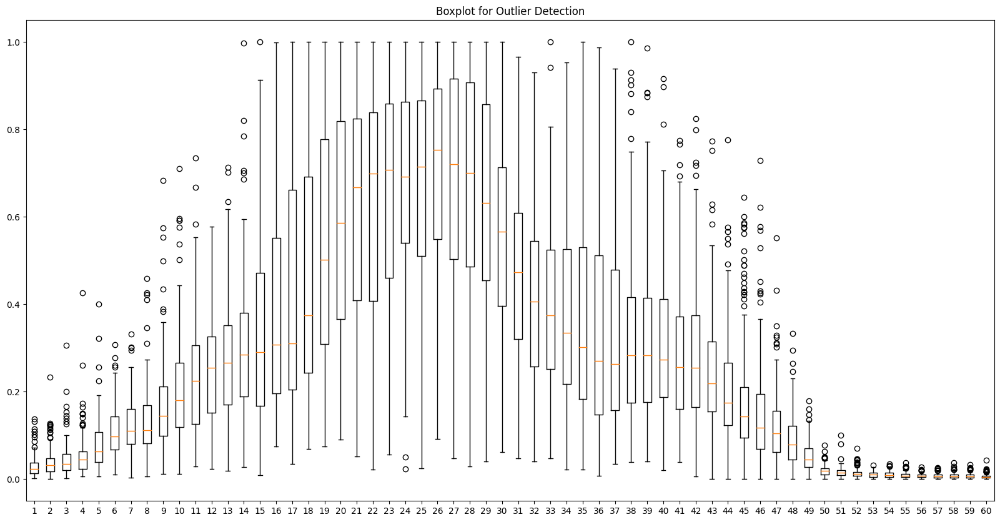

In [22]:
# Boxplot
plt.figure(figsize=(20, 10))
plt.boxplot(X_train)
plt.title('Boxplot for Outlier Detection')
plt.show()

In [23]:
Q1 = X_train.quantile(0.25)
Q3 = X_train.quantile(0.75)
IQR = Q3 - Q1
outliers = X_train[((X_train < (Q1 - 1.5 * IQR)) | (X_train > (Q3 + 1.5 * IQR))).any(axis=1)]

print("Outliers using IQR method:")
print(outliers)

Outliers using IQR method:
         0       1       2       3       4       5       6       7       8   \
33   0.0442  0.0477  0.0049  0.0581  0.0278  0.0678  0.1664  0.1490  0.0974   
45   0.0408  0.0653  0.0397  0.0604  0.0496  0.1817  0.1178  0.1024  0.0583   
100  0.0629  0.1065  0.1526  0.1229  0.1437  0.1190  0.0884  0.0907  0.2107   
129  0.1371  0.1226  0.1385  0.1484  0.1776  0.1428  0.1773  0.2161  0.1630   
134  0.1083  0.1070  0.0257  0.0837  0.0748  0.1125  0.3322  0.4590  0.5526   
80   0.0229  0.0369  0.0040  0.0375  0.0455  0.1452  0.2211  0.1188  0.0750   
127  0.0209  0.0261  0.0120  0.0768  0.1064  0.1680  0.3016  0.3460  0.3314   
102  0.0587  0.1210  0.1268  0.1498  0.1436  0.0561  0.0832  0.0672  0.1372   
104  0.0307  0.0523  0.0653  0.0521  0.0611  0.0577  0.0665  0.0664  0.1460   
165  0.0221  0.0065  0.0164  0.0487  0.0519  0.0849  0.0812  0.1833  0.2228   
167  0.0137  0.0297  0.0116  0.0082  0.0241  0.0253  0.0279  0.0130  0.0489   
156  0.0047  0.0059  0.00

In [24]:
X_train = np.log(X_train + 1)
X_test = np.log(X_test + 1)

**Data Normalization**

In [25]:
scalar = StandardScaler()
X_train = scalar.fit_transform(X_train)
X_test = scalar.transform(X_test)

# **Modeling**

In [26]:
classifiers = [
    ('Logistic Regression', LogisticRegression(random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),
    ('Gradient Boosting', GradientBoostingClassifier(random_state=42)),
    ('K-Nearest Neighbors', KNeighborsClassifier()),
    ('Support Vector Machine', SVC(random_state=42)),
    ('xgboost', xgb.XGBClassifier(tree_method="hist")),
]

In [27]:
for clf_name, clf in classifiers:
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    f1 = f1_score(y_test, y_pred, average='weighted')  # Using weighted average for multi-class classification
    print(f'{clf_name}: F1 Score = {f1:.2f}')
    print(f'{clf_name} Classification Report:\n{classification_report(y_test, y_pred)}')
    print('---------------------------------------------------')

Logistic Regression: F1 Score = 0.82
Logistic Regression Classification Report:
              precision    recall  f1-score   support

           0       0.81      0.88      0.84        33
           1       0.85      0.77      0.81        30

    accuracy                           0.83        63
   macro avg       0.83      0.82      0.82        63
weighted avg       0.83      0.83      0.82        63

---------------------------------------------------
Random Forest: F1 Score = 0.82
Random Forest Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.76      0.82        33
           1       0.77      0.90      0.83        30

    accuracy                           0.83        63
   macro avg       0.83      0.83      0.83        63
weighted avg       0.84      0.83      0.82        63

---------------------------------------------------
Gradient Boosting: F1 Score = 0.83
Gradient Boosting Classification Report:
              prec